# Part I: Portfolio Opmization

### A. Evaluating the performance of a basic 1/n portfolio

In [48]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [49]:
import matplotlib.pyplot as plt
import warnings
import seaborn as sns

plt.style.use('seaborn')
sns.set_palette('cubehelix')

plt.rcParams['figure.figsize'] = [8, 4.5]
plt.rcParams['figure.dpi'] = 300
warnings.simplefilter(action='ignore', category=FutureWarning)

In [50]:
import yfinance as yf
import numpy as np
import pandas as pd
import pyfolio as pf

In [51]:
RISKY_ASSETS = ['AAPL', 'WMT', 'MCD', 'TM','MS']
START_DATE = '2014-12-31'
END_DATE = '2019-12-31'

n_assets = len(RISKY_ASSETS)

[*********************100%***********************]  5 of 5 completed
Downloaded 1259 rows of data.


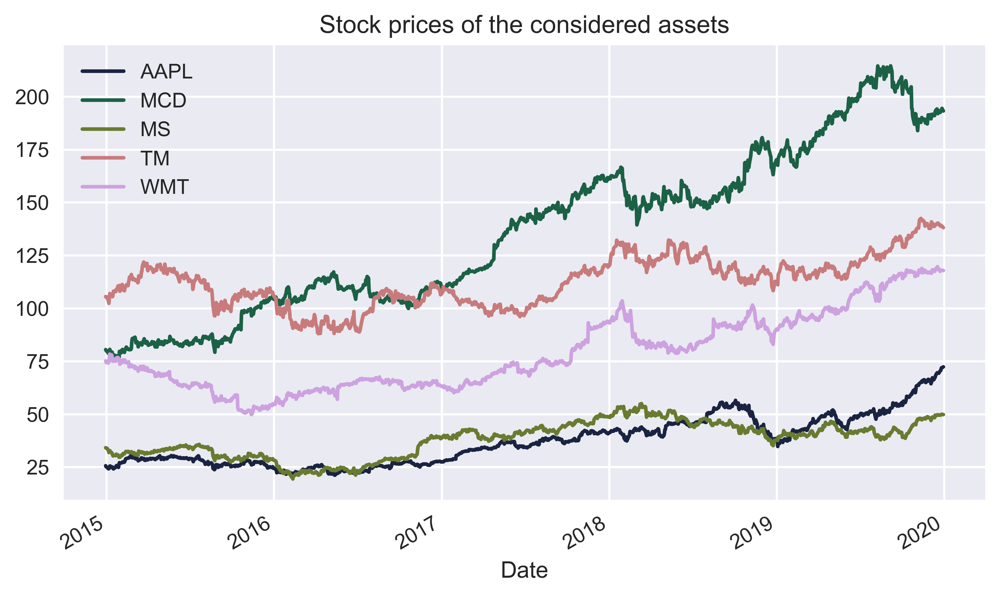

In [52]:
prices_df = yf.download(RISKY_ASSETS, start=START_DATE, 
                        end=END_DATE, adjusted=True)
print(f'Downloaded {prices_df.shape[0]} rows of data.')
prices_df['Adj Close'].plot(title='Stock prices of the considered assets')

In [53]:
returns = prices_df['Adj Close'].pct_change().dropna()

In [54]:
portfolio_weights = n_assets * [1 / n_assets]
portfolio_weights

[0.2, 0.2, 0.2, 0.2, 0.2]

In [55]:
portfolio_returns = pd.Series(np.dot(portfolio_weights, returns.T), 
                              index=returns.index)

In [56]:
pf.create_simple_tear_sheet(portfolio_returns)

Start date,2014-12-31
End date,2019-12-30
Total months,59
,Backtest
Annual return,14.2%
Cumulative returns,94.2%
Annual volatility,14.6%
Sharpe ratio,0.99
Calmar ratio,0.74
Stability,0.88
Max drawdown,-19.3%


### B. Finding the Efficient Frontier using Monte Carlo simulations

In [57]:
import yfinance as yf
import numpy as np
import pandas as pd

In [58]:
N_PORTFOLIOS = 10 ** 5
N_DAYS = 252
RISKY_ASSETS = ['AAPL', 'WMT', 'MCD', 'TM','MS']
RISKY_ASSETS.sort()
START_DATE = '2014-12-31'
END_DATE = '2019-12-31'

n_assets = len(RISKY_ASSETS)

In [59]:
prices_df = yf.download(RISKY_ASSETS, start=START_DATE, 
                        end=END_DATE, adjusted=True)
print(f'Downloaded {prices_df.shape[0]} rows of data.')

[*********************100%***********************]  5 of 5 completed
Downloaded 1259 rows of data.


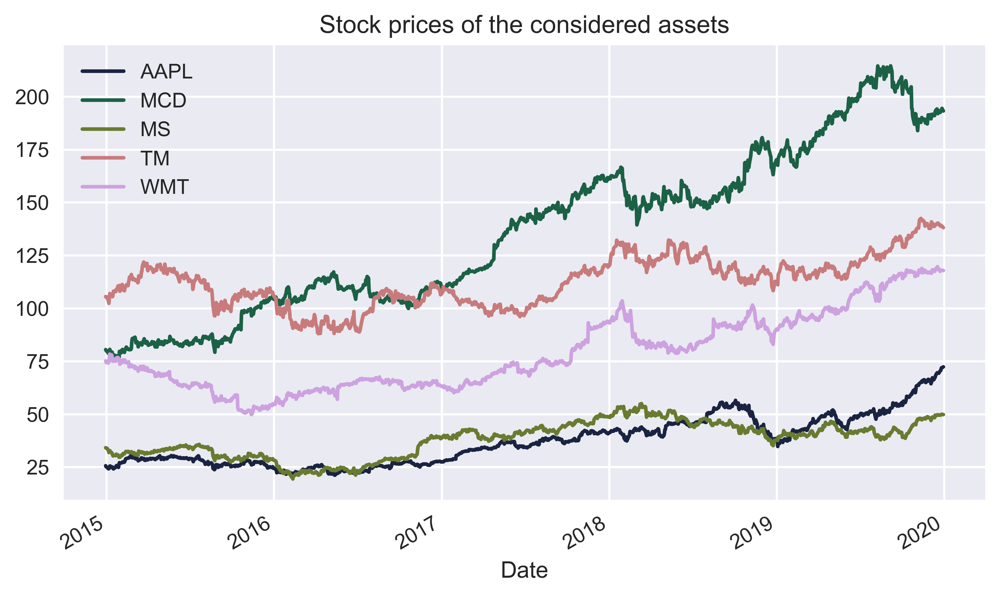

In [60]:
prices_df['Adj Close'].plot(title='Stock prices of the considered assets');

In [61]:
returns_df = prices_df['Adj Close'].pct_change().dropna()

avg_returns = returns_df.mean() * N_DAYS
cov_mat = returns_df.cov() * N_DAYS

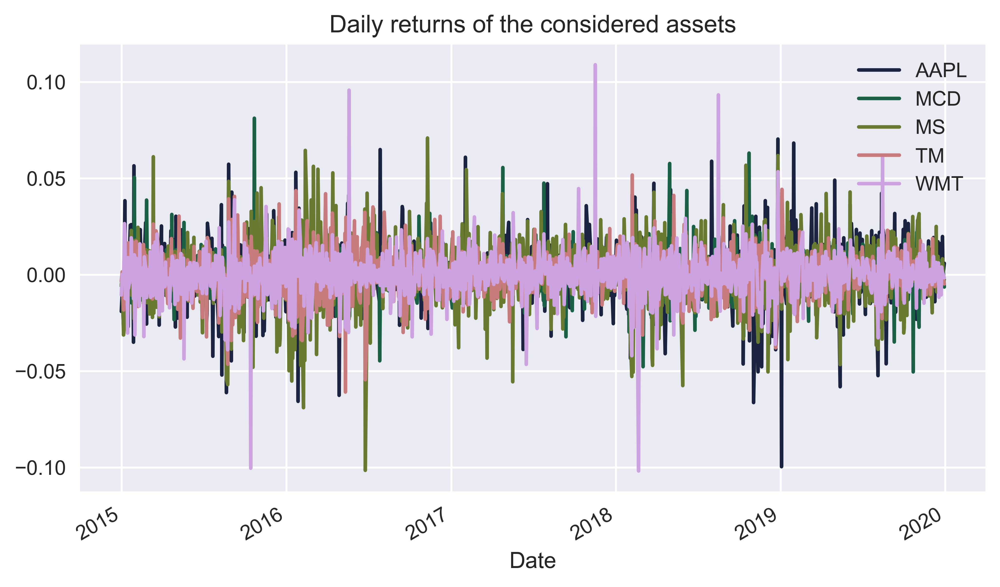

In [62]:
returns_df.plot(title='Daily returns of the considered assets');

In [63]:
np.random.seed(42)
weights = np.random.random(size=(N_PORTFOLIOS, n_assets))
weights /=  np.sum(weights, axis=1)[:, np.newaxis]

In [64]:
portf_rtns = np.dot(weights, avg_returns)

portf_vol = []
for i in range(0, len(weights)):
    portf_vol.append(np.sqrt(np.dot(weights[i].T, 
                                    np.dot(cov_mat, weights[i]))))
portf_vol = np.array(portf_vol)  
portf_sharpe_ratio = portf_rtns / portf_vol

In [65]:
portf_results_df = pd.DataFrame({'returns': portf_rtns,
                                 'volatility': portf_vol,
                                 'sharpe_ratio': portf_sharpe_ratio})

In [66]:
N_POINTS = 100
portf_vol_ef = []
indices_to_skip = []

portf_rtns_ef = np.linspace(portf_results_df.returns.min(), 
                            portf_results_df.returns.max(), 
                            N_POINTS)
portf_rtns_ef = np.round(portf_rtns_ef, 2)    
portf_rtns = np.round(portf_rtns, 2)

for point_index in range(N_POINTS):
    if portf_rtns_ef[point_index] not in portf_rtns:
        indices_to_skip.append(point_index)
        continue
    matched_ind = np.where(portf_rtns == portf_rtns_ef[point_index])
    portf_vol_ef.append(np.min(portf_vol[matched_ind]))
    
portf_rtns_ef = np.delete(portf_rtns_ef, indices_to_skip)

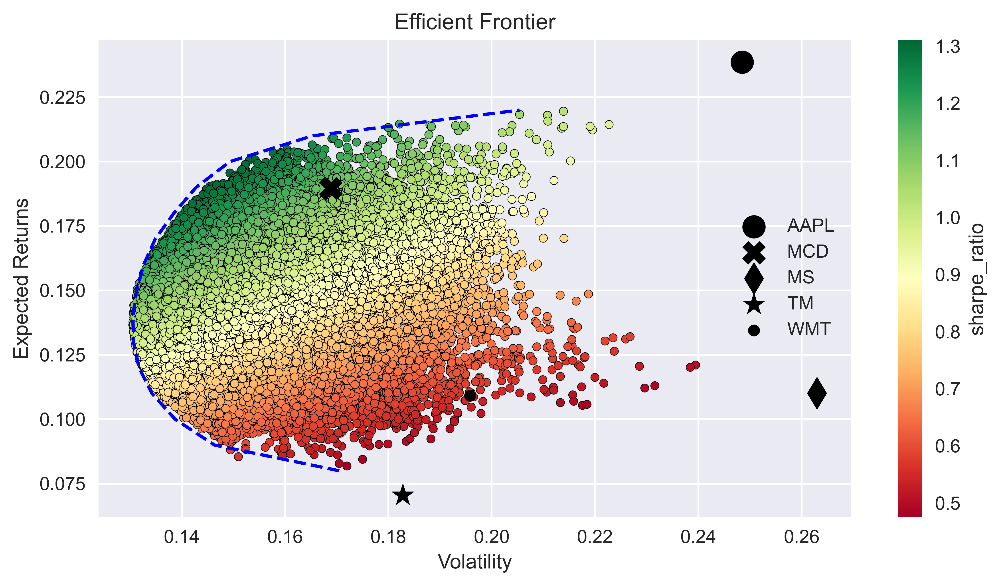

In [67]:
MARKS = ['o', 'X', 'd', '*','.']

fig, ax = plt.subplots()
portf_results_df.plot(kind='scatter', x='volatility', 
                      y='returns', c='sharpe_ratio',
                      cmap='RdYlGn', edgecolors='black', 
                      ax=ax)
ax.set(xlabel='Volatility', 
       ylabel='Expected Returns', 
       title='Efficient Frontier')
ax.plot(portf_vol_ef, portf_rtns_ef, 'b--')
for asset_index in range(n_assets):
    ax.scatter(x=np.sqrt(cov_mat.iloc[asset_index, asset_index]), 
                y=avg_returns[asset_index], 
                marker=MARKS[asset_index], 
                s=150, 
                color='black',
                label=RISKY_ASSETS[asset_index])
ax.legend()

plt.tight_layout()
plt.show()

In [68]:
max_sharpe_ind = np.argmax(portf_results_df.sharpe_ratio)
max_sharpe_portf = portf_results_df.loc[max_sharpe_ind]

min_vol_ind = np.argmin(portf_results_df.volatility)
min_vol_portf = portf_results_df.loc[min_vol_ind]

In [69]:
print('Maximum Sharpe Ratio portfolio ----')
print('Performance')
for index, value in max_sharpe_portf.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)
print('\nWeights')
for x, y in zip(RISKY_ASSETS, weights[np.argmax(portf_results_df.sharpe_ratio)]):
    print(f'{x}: {100*y:.2f}% ', end="", flush=True)

Maximum Sharpe Ratio portfolio ----
Performance
returns: 20.07% volatility: 15.31% sharpe_ratio: 131.03% 
Weights
AAPL: 32.02% MCD: 62.81% MS: 1.39% TM: 1.27% WMT: 2.51% 

In [70]:
print('Minimum Volatility portfolio ----')
print('Performance')
for index, value in min_vol_portf.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)
print('\nWeights')
for x, y in zip(RISKY_ASSETS, weights[np.argmin(portf_results_df.volatility)]):
    print(f'{x}: {100*y:.2f}% ', end="", flush=True)

Minimum Volatility portfolio ----
Performance
returns: 13.66% volatility: 13.05% sharpe_ratio: 104.61% 
Weights
AAPL: 7.15% MCD: 36.40% MS: 0.03% TM: 28.83% WMT: 27.58% 

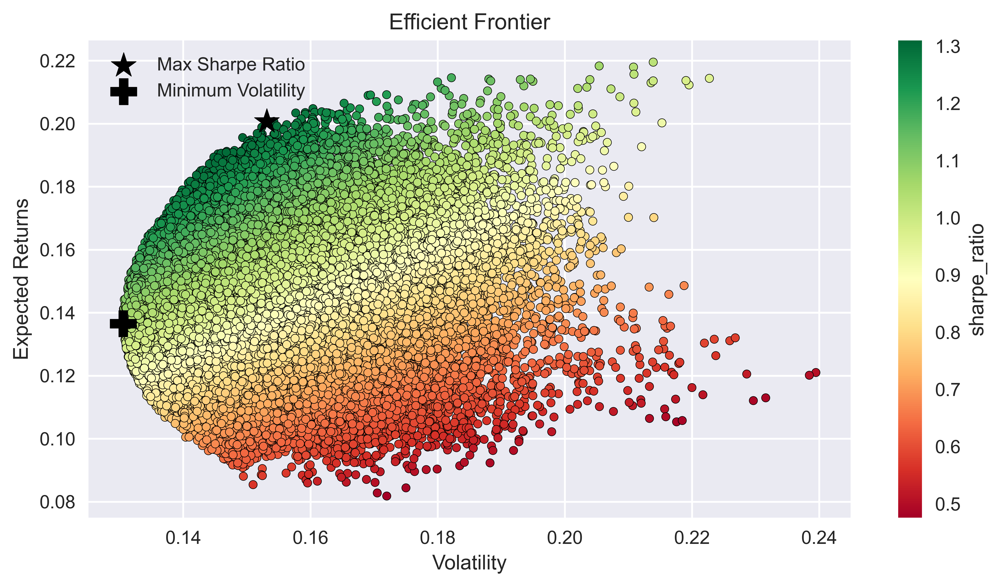

In [71]:
fig, ax = plt.subplots()
portf_results_df.plot(kind='scatter', x='volatility', 
                      y='returns', c='sharpe_ratio',
                      cmap='RdYlGn', edgecolors='black', 
                      ax=ax)
ax.scatter(x=max_sharpe_portf.volatility, 
           y=max_sharpe_portf.returns, 
           c='black', marker='*', 
           s=200, label='Max Sharpe Ratio')
ax.scatter(x=min_vol_portf.volatility, 
           y=min_vol_portf.returns, 
           c='black', marker='P', 
           s=200, label='Minimum Volatility')
ax.set(xlabel='Volatility', ylabel='Expected Returns', 
       title='Efficient Frontier')
ax.legend()

plt.tight_layout()
plt.show()

### C. Finding the Efficient Frontier using optimization with scipy

In [72]:
import numpy as np
import scipy.optimize as sco

In [73]:
def get_portf_rtn(w, avg_rtns):
    return np.sum(avg_rtns * w)

def get_portf_vol(w, avg_rtns, cov_mat):
    return np.sqrt(np.dot(w.T, np.dot(cov_mat, w)))

In [74]:
def get_efficient_frontier(avg_rtns, cov_mat, rtns_range):
    
    efficient_portfolios = []
    
    n_assets = len(avg_returns)
    args = (avg_returns, cov_mat)
    bounds = tuple((0,1) for asset in range(n_assets))
    initial_guess = n_assets * [1. / n_assets, ]
    
    for ret in rtns_range:
        constraints = ({'type': 'eq', 
                        'fun': lambda x: get_portf_rtn(x, avg_rtns) - ret},
                       {'type': 'eq', 
                        'fun': lambda x: np.sum(x) - 1})
        efficient_portfolio = sco.minimize(get_portf_vol, initial_guess, 
                                           args=args, method='SLSQP', 
                                           constraints=constraints,
                                           bounds=bounds)
        efficient_portfolios.append(efficient_portfolio)
    
    return efficient_portfolios

In [75]:
rtns_range = np.linspace(-0.22, 0.32, 200)

In [76]:
efficient_portfolios = get_efficient_frontier(avg_returns, 
                                              cov_mat, 
                                              rtns_range)

In [77]:
vols_range = [x['fun'] for x in efficient_portfolios]

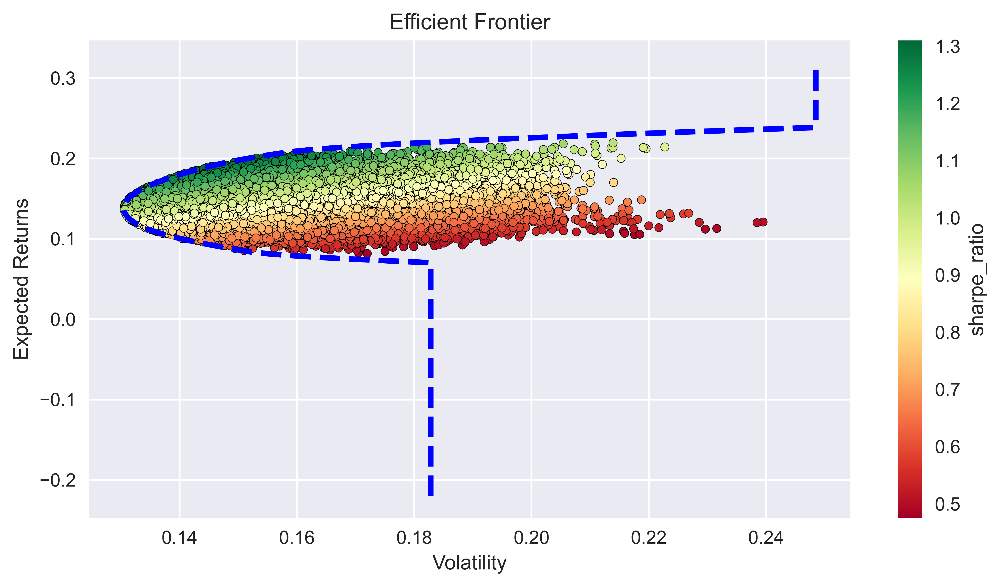

In [78]:
fig, ax = plt.subplots()
portf_results_df.plot(kind='scatter', x='volatility', 
                      y='returns', c='sharpe_ratio',
                      cmap='RdYlGn', edgecolors='black', 
                      ax=ax)
ax.plot(vols_range, rtns_range, 'b--', linewidth=3)
ax.set(xlabel='Volatility', 
       ylabel='Expected Returns', 
       title='Efficient Frontier')

plt.tight_layout()
plt.show()

In [79]:
min_vol_ind = np.argmin(vols_range)
min_vol_portf_rtn = rtns_range[min_vol_ind]
min_vol_portf_vol = efficient_portfolios[min_vol_ind]['fun']

min_vol_portf = {'Return': min_vol_portf_rtn,
                 'Volatility': min_vol_portf_vol,
                 'Sharpe Ratio': (min_vol_portf_rtn / 
                                  min_vol_portf_vol)}

min_vol_portf

{'Return': 0.13819095477386936,
 'Volatility': 0.1304458412386893,
 'Sharpe Ratio': 1.0593741698595671}

In [80]:
print('Minimum Volatility portfolio ----')
print('Performance')

for index, value in min_vol_portf.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)

print('\nWeights')
for x, y in zip(RISKY_ASSETS, efficient_portfolios[min_vol_ind]['x']):
    print(f'{x}: {100*y:.2f}% ', end="", flush=True)

Minimum Volatility portfolio ----
Performance
Return: 13.82% Volatility: 13.04% Sharpe Ratio: 105.94% 
Weights
AAPL: 7.23% MCD: 38.43% MS: 0.00% TM: 29.09% WMT: 25.25% 

In [81]:
def neg_sharpe_ratio(w, avg_rtns, cov_mat, rf_rate):
    portf_returns = np.sum(avg_rtns * w)
    portf_volatility = np.sqrt(np.dot(w.T, np.dot(cov_mat, w)))
    portf_sharpe_ratio = (portf_returns - rf_rate) / portf_volatility
    return -portf_sharpe_ratio

In [82]:
n_assets = len(avg_returns)
RF_RATE = 0

args = (avg_returns, cov_mat, RF_RATE)
constraints = ({'type': 'eq', 
                'fun': lambda x: np.sum(x) - 1})
bounds = tuple((0,1) for asset in range(n_assets))
initial_guess = n_assets * [1. / n_assets]

max_sharpe_portf = sco.minimize(neg_sharpe_ratio, 
                                x0=initial_guess, 
                                args=args,
                                method='SLSQP', 
                                bounds=bounds, 
                                constraints=constraints)

In [83]:
max_sharpe_portf_w = max_sharpe_portf['x']
max_sharpe_portf = {'Return': get_portf_rtn(max_sharpe_portf_w, 
                                            avg_returns),
                    'Volatility': get_portf_vol(max_sharpe_portf_w, 
                                                avg_returns, 
                                                cov_mat),
                    'Sharpe Ratio': -max_sharpe_portf['fun']}
max_sharpe_portf

{'Return': 0.19910753796246405,
 'Volatility': 0.15077341799319444,
 'Sharpe Ratio': 1.320574545650025}

In [84]:
print('Maximum Sharpe Ratio portfolio ----')
print('Performance')

for index, value in max_sharpe_portf.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)

print('\nWeights')
for x, y in zip(RISKY_ASSETS, max_sharpe_portf_w):
    print(f'{x}: {100*y:.2f}% ', end="", flush=True)

Maximum Sharpe Ratio portfolio ----
Performance
Return: 19.91% Volatility: 15.08% Sharpe Ratio: 132.06% 
Weights
AAPL: 31.65% MCD: 60.87% MS: 0.00% TM: 0.00% WMT: 7.48% 

# Part II: Model Fitting

In [85]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [86]:
import matplotlib.pyplot as plt
import warnings
import seaborn as sns

plt.style.use('seaborn')
sns.set_palette('cubehelix')
plt.rcParams['figure.figsize'] = [8, 4.5]
plt.rcParams['figure.dpi'] = 300
warnings.simplefilter(action='ignore', category=FutureWarning)

In [87]:
import os
import sys

import pandas as pd
import numpy as np
import yfinance as yf
from arch import arch_model
import pyfolio as pf

import statsmodels.formula.api as smf
import statsmodels.tsa.api as smt
import statsmodels.api as sm
import scipy.stats as scs
import statsmodels.stats as sms

import matplotlib.pyplot as plt
import matplotlib as mpl

### A. Apple (AAPL) 

In [88]:
df_yahoo_AAPL= yf.download('AAPL', 
                       start='2014-12-31', 
                       end='2019-12-31',
                       progress=False)

In [89]:
print(f'Downloaded {df_yahoo_AAPL.shape[0]} rows of data.')

Downloaded 1259 rows of data.


In [90]:
data = df_yahoo_AAPL['Adj Close']

In [91]:
def tsplot(y, lags=None, figsize=(15, 10), style='bmh'):
    if not isinstance(y, pd.Series):
        y = pd.Series(y)
    with plt.style.context(style):    
        fig = plt.figure(figsize=figsize)
        #mpl.rcParams['font.family'] = 'Ubuntu Mono'
        layout = (3, 2)
        ts_ax = plt.subplot2grid(layout, (0, 0), colspan=2)
        acf_ax = plt.subplot2grid(layout, (1, 0))
        pacf_ax = plt.subplot2grid(layout, (1, 1))
        qq_ax = plt.subplot2grid(layout, (2, 0))
        pp_ax = plt.subplot2grid(layout, (2, 1))
        
        y.plot(ax=ts_ax)
        ts_ax.set_title('Time Series Analysis Plots')
        smt.graphics.plot_acf(y, lags=lags, ax=acf_ax, alpha=0.05)
        smt.graphics.plot_pacf(y, lags=lags, ax=pacf_ax, alpha=0.05)
        sm.qqplot(y, line='s', ax=qq_ax)
        qq_ax.set_title('QQ Plot')        
        scs.probplot(y, sparams=(y.mean(), y.std()), plot=pp_ax)
        plt.tight_layout()
    return 

Random Walk

In [92]:
_ = tsplot(np.diff(data), lags=30)

ARMA -- AR Process

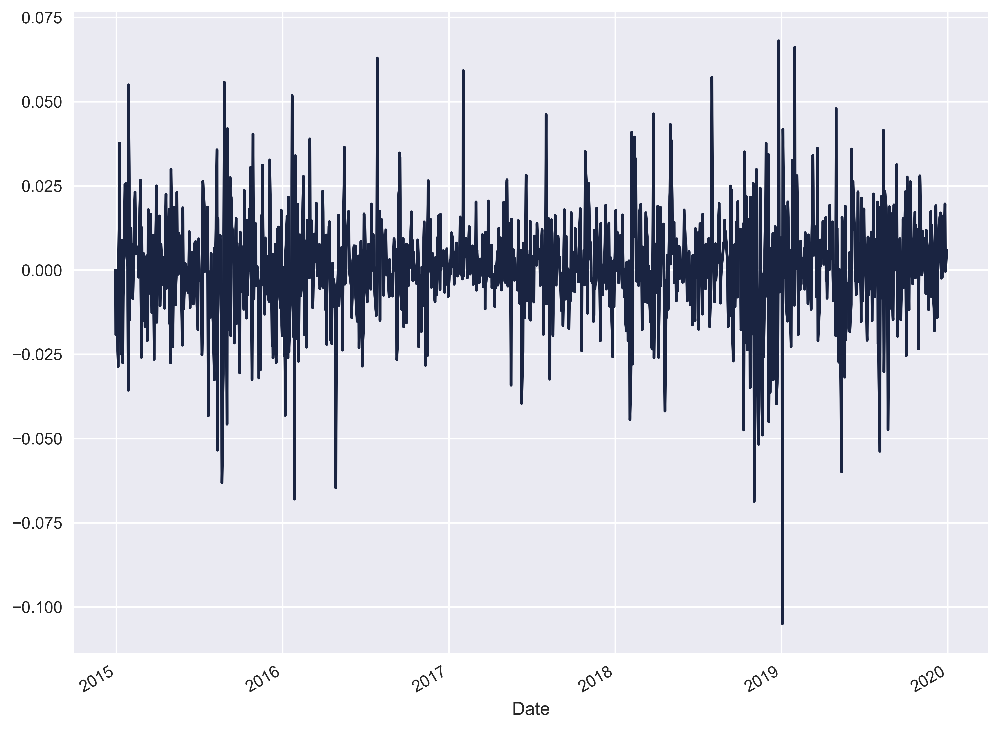

In [93]:
retns_data = np.log(data/data.shift(1)).fillna(0)
retns_data.plot(figsize=(10, 8))

In [94]:
max_lag = 30
mdl = smt.AR(retns_data).fit(maxlag=max_lag, ic='aic', trend='nc')
est_order = smt.AR(retns_data).select_order(maxlag=max_lag, ic='aic', trend='nc')

print('best estimated lag order = %s'%(est_order))

_ = tsplot(mdl.resid, lags=max_lag)

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


best estimated lag order = 9


In [95]:
from statsmodels.stats.stattools import jarque_bera

score, pvalue, _, _ = jarque_bera(mdl.resid)

if pvalue < 0.10:
    print ('We have reason to suspect the residuals are not normally distributed.')
else:
    print ('The residuals seem normally distributed.')

We have reason to suspect the residuals are not normally distributed.


ARMA -- MA Process

In [96]:
# Fit MA(1) to AAPL log returns

max_lag = 30
Y = retns_data
mdl = smt.ARMA(Y, order=(0, 1)).fit(
    maxlag=max_lag, method='mle', trend='nc')
print(mdl.summary())
_ = tsplot(mdl.resid, lags=max_lag)

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                              ARMA Model Results                              
Dep. Variable:              Adj Close   No. Observations:                 1259
Model:                     ARMA(0, 1)   Log Likelihood                3444.757
Method:                           mle   S.D. of innovations              0.016
Date:                Wed, 30 Sep 2020   AIC                          -6885.514
Time:                        15:57:24   BIC                          -6875.238
Sample:                             0   HQIC                         -6881.652
                                                                              
                      coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------
ma.L1.Adj Close     0.0134      0.030      0.454      0.650      -0.044       0.071
                                    Roots                                    
                  Real          Imagin

In [97]:
# Fit MA(2) to AAPL log returns

max_lag = 30
Y = retns_data
mdl = smt.ARMA(Y, order=(0, 2)).fit(
    maxlag=max_lag, method='mle', trend='nc')
print(mdl.summary())
_ = tsplot(mdl.resid, lags=max_lag)

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                              ARMA Model Results                              
Dep. Variable:              Adj Close   No. Observations:                 1259
Model:                     ARMA(0, 2)   Log Likelihood                3446.066
Method:                           mle   S.D. of innovations              0.016
Date:                Wed, 30 Sep 2020   AIC                          -6886.132
Time:                        15:57:34   BIC                          -6870.718
Sample:                             0   HQIC                         -6880.340
                                                                              
                      coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------
ma.L1.Adj Close     0.0110      0.028      0.391      0.695      -0.044       0.066
ma.L2.Adj Close    -0.0455      0.028     -1.621      0.105      -0.101       0.010
                                

In [98]:
from statsmodels.stats.stattools import jarque_bera

score, pvalue, _, _ = jarque_bera(mdl.resid)

if pvalue < 0.10:
    print ('We have reason to suspect the residuals are not normally distributed.')
else:
    print ('The residuals seem normally distributed.')

We have reason to suspect the residuals are not normally distributed.


In [99]:
# Fit MA(3) to SPX log returns

max_lag = 30
Y = retns_data
mdl = smt.ARMA(Y, order=(0, 3)).fit(
    maxlag=max_lag, method='mle', trend='nc')
print(mdl.summary())
_ = tsplot(mdl.resid, lags=max_lag)

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                              ARMA Model Results                              
Dep. Variable:              Adj Close   No. Observations:                 1259
Model:                     ARMA(0, 3)   Log Likelihood                3446.279
Method:                           mle   S.D. of innovations              0.016
Date:                Wed, 30 Sep 2020   AIC                          -6884.559
Time:                        15:57:49   BIC                          -6864.006
Sample:                             0   HQIC                         -6876.835
                                                                              
                      coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------
ma.L1.Adj Close     0.0121      0.028      0.429      0.668      -0.043       0.067
ma.L2.Adj Close    -0.0447      0.028     -1.602      0.109      -0.099       0.010
ma.L3.Adj Close    -0.0183      

In [100]:
from statsmodels.stats.stattools import jarque_bera

score, pvalue, _, _ = jarque_bera(mdl.resid)

if pvalue < 0.10:
    print ('We have reason to suspect the residuals are not normally distributed.')
else:
    print ('The residuals seem normally distributed.')

We have reason to suspect the residuals are not normally distributed.


ARMA Model

In [101]:
from numpy.linalg import LinAlgError
# Fit ARMA model to AAPL returns

TS = retns_data.dropna()
TS.index = pd.DatetimeIndex(TS.index.values,
                               freq=TS.index.inferred_freq)

best_aic = np.inf 
best_order = None
best_mdl = None

rng = range(1,5) # [0,1,2,3,4,5]
for i in rng:
    for j in rng:
        try:
            tmp_mdl = smt.ARMA(TS, order=(i, j)).fit(method='mle', trend='nc')
            tmp_aic = tmp_mdl.aic
            if tmp_aic < best_aic:
                best_aic = tmp_aic
                best_order = (i, j)
                best_mdl = tmp_mdl
        except (ValueError, LinAlgError) as e: continue


print('aic: {:6.5f} | order: {}'.format(best_aic, best_order))

_ = tsplot(best_mdl.resid, lags=max_lag)

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no ass

aic: -6888.09145 | order: (3, 3)


In [102]:
sms.diagnostic.acorr_ljungbox(best_mdl.resid, lags=[20], boxpierce=False)

(array([17.80791602]), array([0.60006015]))

ARIMA Model

In [103]:
# Fit ARIMA(p, d, q) model to AAPL log returns
# pick best order and final model based on aic

TS = retns_data.dropna()
TS.index = pd.DatetimeIndex(TS.index.values,
                               freq=TS.index.inferred_freq)

best_aic = np.inf 
best_order = None
best_mdl = None


pq_rng = range(5) # [0,1,2,3]
d_rng = range(2) # [0,1]
for i in pq_rng:
    for d in d_rng:
        for j in pq_rng:
            try:
                tmp_mdl = smt.ARIMA(TS, order=(i,d,j)).fit(method='mle', trend='nc')
                tmp_aic = tmp_mdl.aic
                if tmp_aic < best_aic:
                    best_aic = tmp_aic
                    best_order = (i, d, j)
                    best_mdl = tmp_mdl
            except: continue


print('aic: {:6.5f} | order: {}'.format(best_aic, best_order))

# ARIMA model resid plot
_ = tsplot(best_mdl.resid, lags=30)

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no ass

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no ass

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no ass

aic: -6888.09145 | order: (3, 0, 3)


In [104]:
sms.diagnostic.acorr_ljungbox(best_mdl.resid, lags=[20], boxpierce=False)

(array([17.80791602]), array([0.60006015]))

### B. McDonald (MCD) 

In [105]:
from backtester.dataSource.yahoo_data_source import YahooStockDataSource
startDateStr = '2014/12/31'
endDateStr = '2019/12/31'
cachedFolderName = 'yahooData/'
dataSetId = 'testPairsTrading'
instrumentIds = ['MCD']
ds = YahooStockDataSource(cachedFolderName=cachedFolderName,
                            dataSetId=dataSetId,
                            instrumentIds=instrumentIds,
                            startDateStr=startDateStr,
                            endDateStr=endDateStr,
                            event='history')
data = ds.getBookDataByFeature()['adjClose']
# log returns
lrets = np.log(data/data.shift(1)).dropna()

Processing data for stock: MCD
20% done...
40% done...
60% done...
80% done...


Random Walk

In [106]:
_ = tsplot(np.diff(data['MCD']), lags=30)

Log-linear Model

In [107]:
_ = tsplot(np.log(data['MCD']), lags=30) 

ARMA Model

In [108]:
# Select best lag order for MCD returns

max_lag = 10
mdl = smt.AR(lrets).fit(maxlag=max_lag, ic='aic', trend='nc')
est_order = smt.AR(lrets).select_order(maxlag=max_lag, ic='aic', trend='nc')

print('best estimated lag order = %s'%(est_order))

_ = tsplot(mdl.resid, lags=max_lag)

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


best estimated lag order = 2


In [109]:
max_lag = 30
Y = lrets
mdl = smt.ARMA(Y, order=(0, 2)).fit(
    maxlag=max_lag, method='mle', trend='nc')
print(mdl.summary())
_ = tsplot(mdl.resid, lags=max_lag)

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:216: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                              ARMA Model Results                              
Dep. Variable:                    MCD   No. Observations:                 1258
Model:                     ARMA(0, 2)   Log Likelihood                3934.806
Method:                           mle   S.D. of innovations              0.011
Date:                Wed, 30 Sep 2020   AIC                          -7863.612
Time:                        16:11:58   BIC                          -7848.200
Sample:                             0   HQIC                         -7857.820
                                                                              
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1.MCD     -0.0372      0.028     -1.323      0.186      -0.092       0.018
ma.L2.MCD     -0.0545      0.028     -1.946      0.052      -0.109       0.000
                                    Roots           

In [110]:
# Simulate an ARMA(2, 2) model with alphas=[0.5,-0.25] and betas=[0.5,-0.3]
max_lag = 30

n = int(5000) # lots of samples to help estimates
burn = int(n/10) # number of samples to discard before fit

alphas = np.array([0.5, -0.25])
betas = np.array([0.5, -0.3])
ar = np.r_[1, -alphas]
ma = np.r_[1, betas]

arma22 = smt.arma_generate_sample(ar=ar, ma=ma, nsample=n, burnin=burn)
_ = tsplot(arma22, lags=max_lag)

In [111]:
mdl = smt.ARMA(arma22, order=(2, 2)).fit(
    maxlag=max_lag, method='mle', trend='nc', burnin=burn)
print(mdl.summary())

                              ARMA Model Results                              
Dep. Variable:                      y   No. Observations:                 5000
Model:                     ARMA(2, 2)   Log Likelihood               -7094.450
Method:                           mle   S.D. of innovations              1.000
Date:                Wed, 30 Sep 2020   AIC                          14198.900
Time:                        16:12:07   BIC                          14231.486
Sample:                             0   HQIC                         14210.321
                                                                              
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1.y        0.4630      0.052      8.851      0.000       0.360       0.566
ar.L2.y       -0.2651      0.015    -17.428      0.000      -0.295      -0.235
ma.L1.y        0.5629      0.054     10.517      0.0

In [112]:
# Simulate an ARMA(3, 2) model with alphas=[0.5,-0.4,0.25] and betas=[0.5,-0.3]

max_lag = 30

n = int(5000)
burn = 2000

alphas = np.array([0.5, -0.4, 0.25])
betas = np.array([0.5, -0.3])

ar = np.r_[1, -alphas]
ma = np.r_[1, betas]

arma32 = smt.arma_generate_sample(ar=ar, ma=ma, nsample=n, burnin=burn)
_ = tsplot(arma32, lags=max_lag)


In [113]:
# pick best order by aic 
# smallest aic value wins
best_aic = np.inf 
best_order = None
best_mdl = None

rng = range(5)
for i in rng:
    for j in rng:
        try:
            tmp_mdl = smt.ARMA(arma32, order=(i, j)).fit(method='mle', trend='nc')
            tmp_aic = tmp_mdl.aic
            if tmp_aic < best_aic:
                best_aic = tmp_aic
                best_order = (i, j)
                best_mdl = tmp_mdl
        except: continue


print('aic: %6.5f | order: %s'%(best_aic, best_order))

aic: 14139.88812 | order: (3, 2)


In [114]:
sms.diagnostic.acorr_ljungbox(best_mdl.resid, lags=[20], boxpierce=False)

(array([10.020426]), array([0.96780005]))

# Part III: Prediction for Future Returns

In [115]:
import pandas as pd
import datetime
import numpy as np
import pandas_datareader.data as web
from pandas import Series, DataFrame
import matplotlib.pyplot as plt
%matplotlib inline

### A. Apple (AAPL)

Data Download

In [116]:
start = datetime.datetime(2014, 12, 3)
end = datetime.datetime(2019, 7, 31)

df = web.DataReader("AAPL", 'yahoo', start, end)
df.tail()

,High,Low,Open,Close,Volume,Adj Close
Date,,,,,,
2019-07-25,52.310001,51.682499,52.222500,51.755001,55638400.0,51.052570
2019-07-26,52.432499,51.785000,51.869999,51.935001,70475600.0,51.230125
2019-07-29,52.660000,52.110001,52.115002,52.419998,86693600.0,51.708538
2019-07-30,52.540001,51.827499,52.189999,52.195000,135742800.0,51.486591
2019-07-31,55.342499,52.825001,54.105000,53.259998,277125600.0,52.537140


Moving Average

In [117]:
close = df['Adj Close']
moving_avg = close.rolling(130).mean()

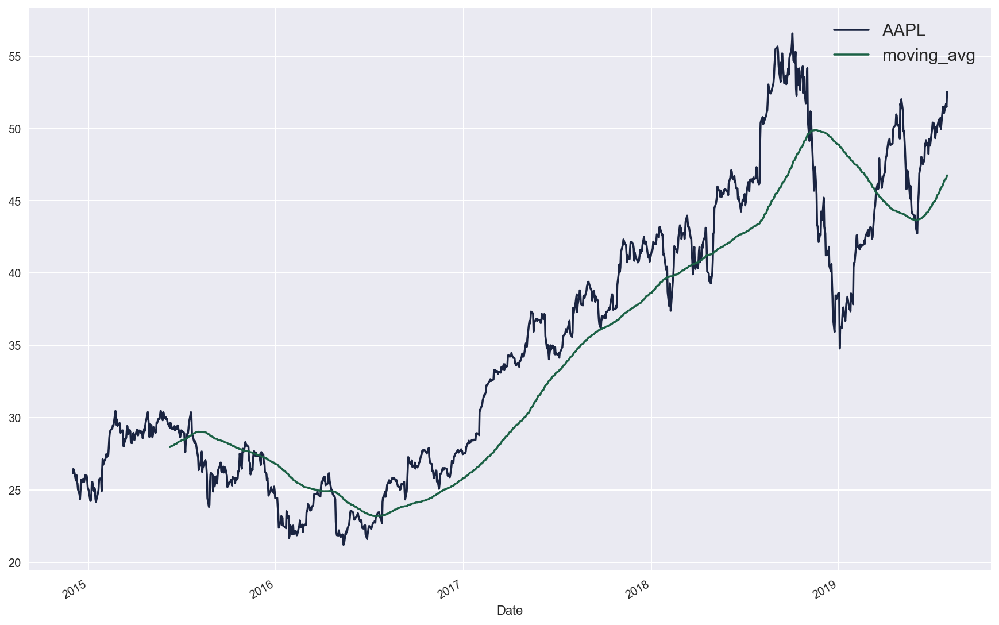

In [118]:
plt.figure(figsize=(15,10))
close.plot(label='AAPL')
moving_avg.plot(label='moving_avg')
plt.legend(fontsize=15)

Return

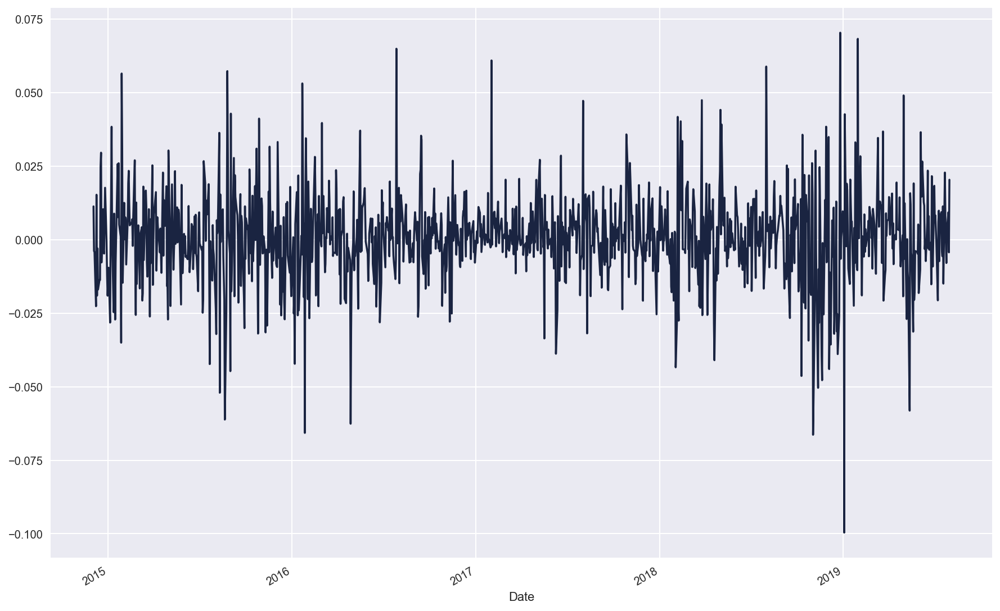

In [119]:
rets = close / close.shift(1) - 1
rets.plot(label='return', figsize=(15,10))

Model Fitting

In [120]:
dfreg = df.loc[:,['Adj Close','Volume']]
dfreg['HL_PCT'] = (df['High'] - df['Low']) / df['Close'] * 100.0
dfreg['PCT_change'] = (df['Close'] - df['Open']) / df['Open'] * 100.0
dfreg['Volatility'] = rets.rolling(130).std()
dfreg['Moving_average'] = moving_avg
dfreg.tail()

,Adj Close,Volume,HL_PCT,PCT_change,Volatility,Moving_average
Date,,,,,,
2019-07-25,51.052570,55638400.0,1.212448,-0.895206,0.015474,46.321949
2019-07-26,51.230125,70475600.0,1.246749,0.125318,0.015471,46.420950
2019-07-29,51.708538,86693600.0,1.049216,0.585237,0.015326,46.530254
2019-07-30,51.486591,135742800.0,1.365076,0.009582,0.015338,46.636685
2019-07-31,52.537140,277125600.0,4.726808,-1.561780,0.015389,46.753492


In [126]:
from sklearn.preprocessing import scale

# Drop missing value
dfreg.dropna(inplace=True)

forecast_out = 22

# Creating the label
dfreg['label'] = dfreg['Adj Close'].shift(-forecast_out)
X = np.array(dfreg.drop(['label'], 1))

# Scale the X so that everyone can have the same distribution for regression
X = scale(X)

X_OOS = X[-forecast_out:]
X_IS = X[:-forecast_out]

# Separate label and identify it as y
y = np.array(dfreg['label'])
y_OOS = y[-forecast_out:]
y_IS = y[:-forecast_out]

/opt/anaconda3/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:174: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn("Numerical issues were encountered "


In [127]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.linear_model import LinearRegression

In [128]:
lr = LinearRegression()
dt = DecisionTreeRegressor(random_state=0)
rf = RandomForestRegressor(n_estimators=100, max_features=6, n_jobs=-1, random_state=0)
gb = GradientBoostingRegressor(learning_rate=0.1, max_depth=3, n_estimators=200, random_state=0)

In [129]:
lr.fit(X_IS, y_IS)

LinearRegression()

In [130]:
dt.fit(X_IS, y_IS)

DecisionTreeRegressor(random_state=0)

In [131]:
rf.fit(X_IS, y_IS)

RandomForestRegressor(max_features=6, n_jobs=-1, random_state=0)

In [132]:
gb.fit(X_IS, y_IS)

GradientBoostingRegressor(n_estimators=200, random_state=0)

Prediction

In [133]:
lr_pred = pd.Series(lr.predict(X_OOS), index=df.index[-forecast_out:])
dt_pred = pd.Series(dt.predict(X_OOS), index=df.index[-forecast_out:])
rf_pred = pd.Series(rf.predict(X_OOS), index=df.index[-forecast_out:])
gb_pred = pd.Series(gb.predict(X_OOS), index=df.index[-forecast_out:])

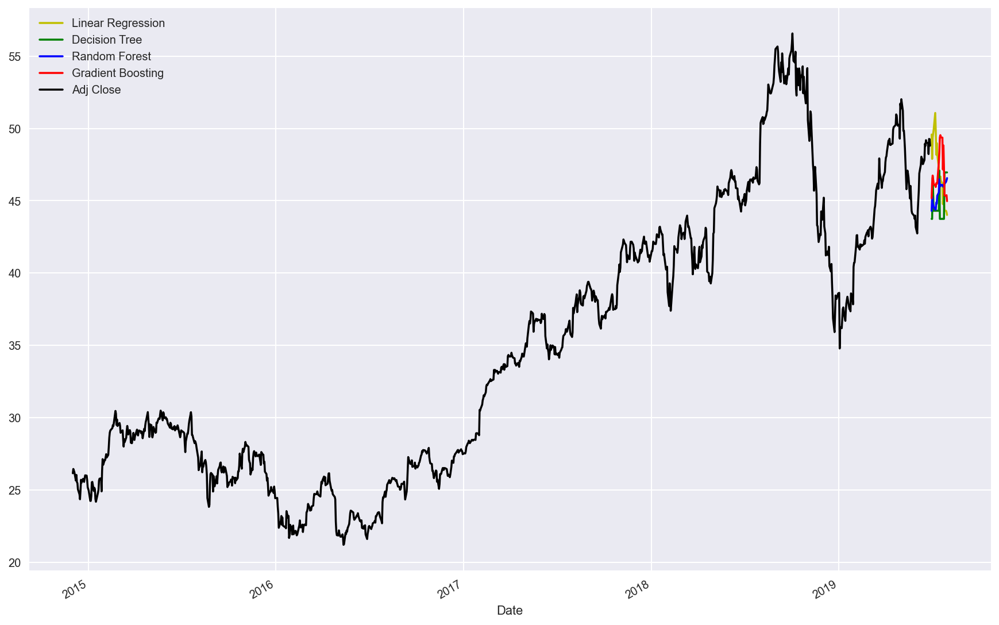

In [134]:
plt.figure(figsize=(15,10))
lr_pred.plot(label='Linear Regression', c='y')
dt_pred.plot(label='Decision Tree', c='g')
rf_pred.plot(label='Random Forest', c='b')
gb_pred.plot(label='Gradient Boosting', c='r')
df['Adj Close'][:-forecast_out].plot(c='k')
plt.legend()

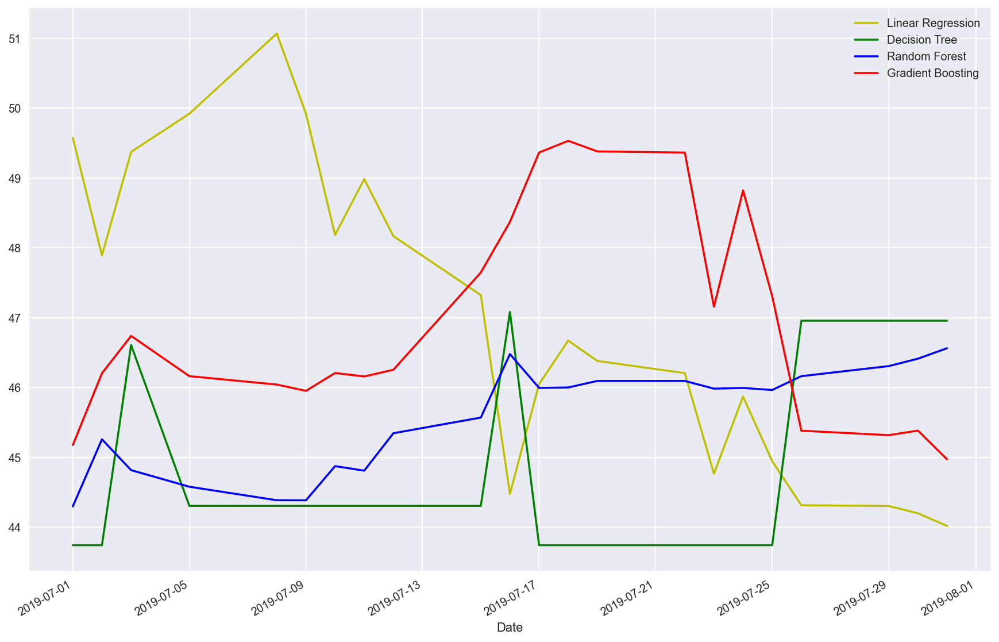

In [135]:
plt.figure(figsize=(15,10))
lr_pred.plot(label='Linear Regression', c='y')
dt_pred.plot(label='Decision Tree', c='g')
rf_pred.plot(label='Random Forest', c='b')
gb_pred.plot(label='Gradient Boosting', c='r')
plt.legend()

### B. McDonald (MCD) 

Data Preparation

In [136]:
start = datetime.datetime(2014, 12, 31)
end = datetime.datetime(2019, 12, 31)

df = web.DataReader("MCD", 'yahoo', start, end)
df.tail()

,High,Low,Open,Close,Volume,Adj Close
Date,,,,,,
2019-12-24,197.139999,195.669998,195.929993,196.669998,1152500.0,193.023178
2019-12-26,197.160004,196.160004,196.610001,197.059998,1809600.0,193.405945
2019-12-27,198.470001,197.179993,197.330002,198.169998,2263900.0,194.495361
2019-12-30,197.800003,195.940002,197.580002,196.910004,2242400.0,193.258728
2019-12-31,197.949997,196.559998,196.800003,197.610001,2278700.0,193.945755


Moving Average

In [137]:
close = df['Adj Close']
moving_avg = close.rolling(130).mean()

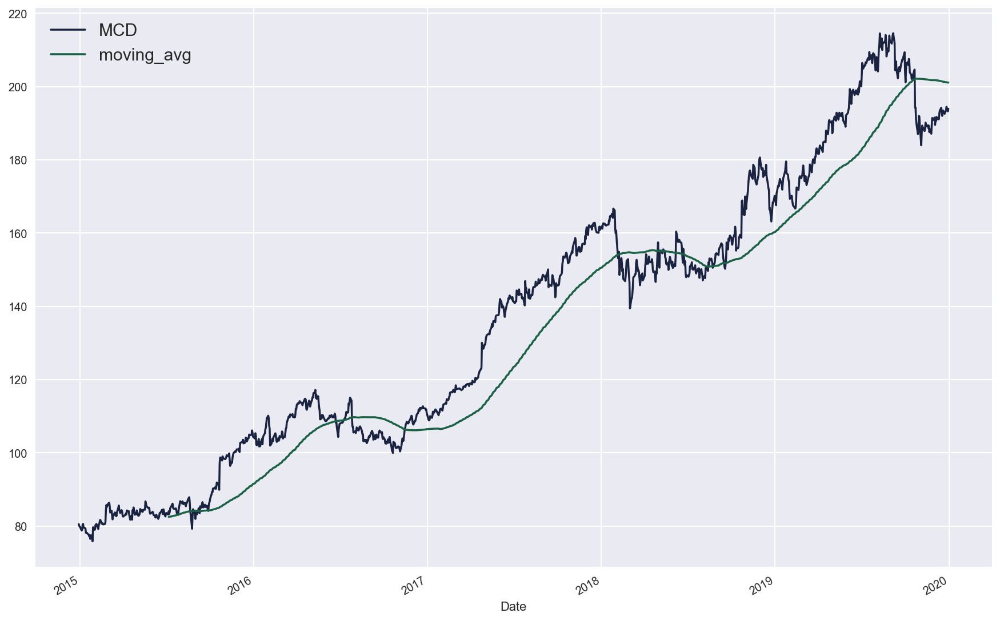

In [138]:
plt.figure(figsize=(15,10))
close.plot(label='MCD')
moving_avg.plot(label='moving_avg')
plt.legend(fontsize=15)

Return

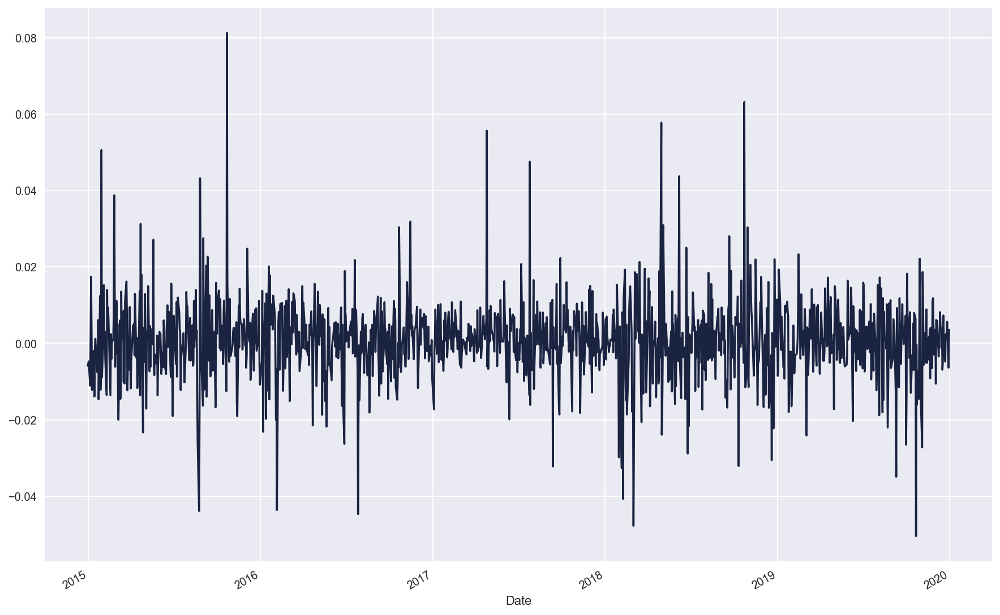

In [139]:
rets = close / close.shift(1) - 1
rets.plot(label='return', figsize=(15,10))

Model Fitting

In [140]:
dfreg = df.loc[:,['Adj Close','Volume']]
dfreg['HL_PCT'] = (df['High'] - df['Low']) / df['Close'] * 100.0
dfreg['PCT_change'] = (df['Close'] - df['Open']) / df['Open'] * 100.0
dfreg['Volatility'] = rets.rolling(130).std()
dfreg['Moving_average'] = moving_avg
dfreg.tail()

,Adj Close,Volume,HL_PCT,PCT_change,Volatility,Moving_average
Date,,,,,,
2019-12-24,193.023178,1152500.0,0.747446,0.377689,0.010614,201.239538
2019-12-26,193.405945,1809600.0,0.507460,0.228878,0.010609,201.203059
2019-12-27,194.495361,2263900.0,0.650961,0.425681,0.010621,201.177498
2019-12-30,193.258728,2242400.0,0.944594,-0.339102,0.010606,201.129067
2019-12-31,193.945755,2278700.0,0.703405,0.411584,0.010600,201.094577


In [141]:
from sklearn.preprocessing import scale

# Drop missing value
dfreg.dropna(inplace=True)

forecast_out = 22

# Creating the label
dfreg['label'] = dfreg['Adj Close'].shift(-forecast_out)
X = np.array(dfreg.drop(['label'], 1))

# Scale the X so that everyone can have the same distribution for regression
X = scale(X)

X_OOS = X[-forecast_out:]
X_IS = X[:-forecast_out]

# Separate label and identify it as y
y = np.array(dfreg['label'])
y_OOS = y[-forecast_out:]
y_IS = y[:-forecast_out]

In [142]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.linear_model import LinearRegression

In [143]:
lr = LinearRegression()
dt = DecisionTreeRegressor(random_state=0)
rf = RandomForestRegressor(n_estimators=100, max_features=6, n_jobs=-1, random_state=0)
gb = GradientBoostingRegressor(learning_rate=0.1, max_depth=3, n_estimators=200, random_state=0)

In [144]:
lr.fit(X_IS, y_IS)

LinearRegression()

In [145]:
dt.fit(X_IS, y_IS)

DecisionTreeRegressor(random_state=0)

In [146]:
rf.fit(X_IS, y_IS)

RandomForestRegressor(max_features=6, n_jobs=-1, random_state=0)

In [147]:
gb.fit(X_IS, y_IS)

GradientBoostingRegressor(n_estimators=200, random_state=0)

Prediction

In [148]:
lr_pred = pd.Series(lr.predict(X_OOS), index=df.index[-forecast_out:])
dt_pred = pd.Series(dt.predict(X_OOS), index=df.index[-forecast_out:])
rf_pred = pd.Series(rf.predict(X_OOS), index=df.index[-forecast_out:])
gb_pred = pd.Series(gb.predict(X_OOS), index=df.index[-forecast_out:])

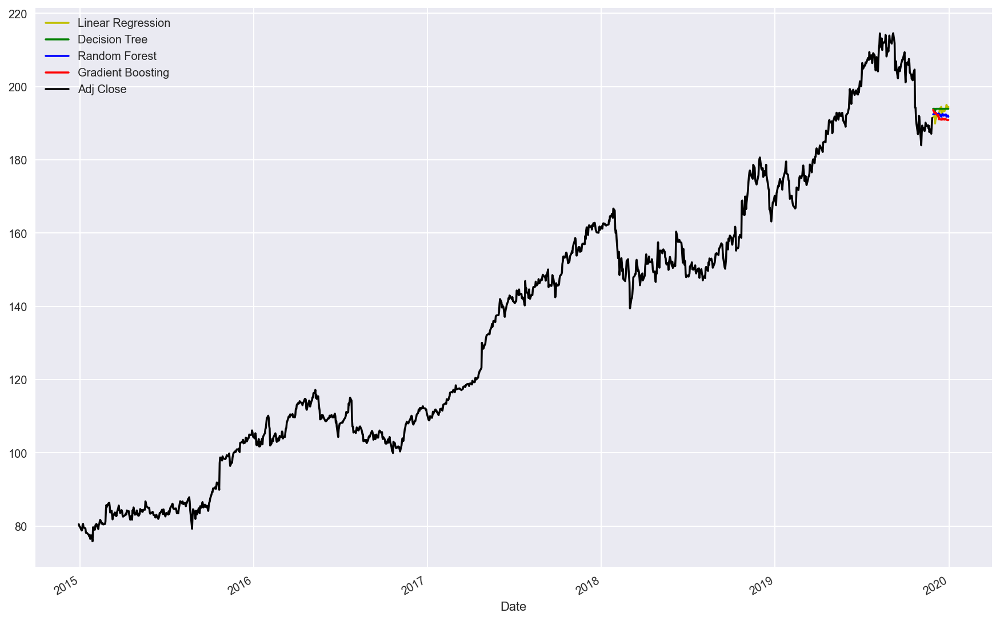

In [149]:
plt.figure(figsize=(15,10))
lr_pred.plot(label='Linear Regression', c='y')
dt_pred.plot(label='Decision Tree', c='g')
rf_pred.plot(label='Random Forest', c='b')
gb_pred.plot(label='Gradient Boosting', c='r')
df['Adj Close'][:-forecast_out].plot(c='k')
plt.legend()

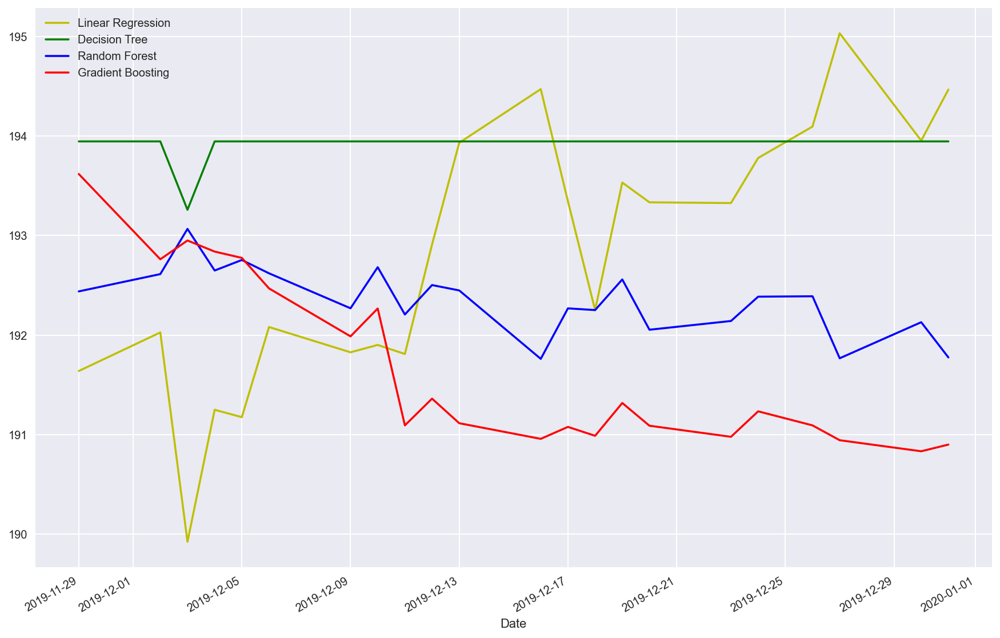

In [150]:
plt.figure(figsize=(15,10))
lr_pred.plot(label='Linear Regression', c='y')
dt_pred.plot(label='Decision Tree', c='g')
rf_pred.plot(label='Random Forest', c='b')
gb_pred.plot(label='Gradient Boosting', c='r')
plt.legend()